In [ ]:
!pip install rasterio

In [1]:
import numpy as np
import pandas as pd

In [2]:
from pathlib import Path

from tqdm.notebook import tqdm

import sys, os, random, time, glob, zarr, json
import numba, cv2, gc
import pickle

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.data as D

import torchvision
from torchvision import transforms as T
from segmentation_models_pytorch import Unet
from segmentation_models_pytorch import MAnet
from segmentation_models_pytorch import FPN
from segmentation_models_pytorch import Linknet
from segmentation_models_pytorch import PAN
from segmentation_models_pytorch import UnetPlusPlus

import rasterio
from rasterio.windows import Window

import albumentations as A

In [3]:
from config.global_vars import *

### Configuration

In [4]:
DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'

In [5]:
DATA_PATH = Path('/home/jupyter/data_2/')
assert DATA_PATH.exists()

# path to our training notebook.
PATH_FOLD_MODELS = Path('models')
assert PATH_FOLD_MODELS.exists()

### Functions

In [6]:
@numba.njit()
def rle_numba(pixels):
    size = len(pixels)
    points = []
    if pixels[0] == 1: points.append(1)
    for i in range(1, size):
        if pixels[i] != pixels[i-1]:
            if len(points) % 2 == 0:
                points.append(i+1)
            else:
                points.append(i+1 - points[-1])
    if pixels[-1] == 1: points.append(size-points[-1]+1)    
    return points

def rle_numba_encode(image):
    pixels = image.flatten(order = 'F')
    points = rle_numba(pixels)
    return ' '.join(str(x) for x in points)

def rle_encode_less_memory(img):
    pixels = img.T.flatten()
    pixels[0] = 0
    pixels[-1] = 0
    runs = np.where(pixels[1:] != pixels[:-1])[0] + 2
    runs[1::2] -= runs[::2]
    return ' '.join(str(x) for x in runs)

def make_grid(shape, window=256, min_overlap=32):
    """
        Return Array of size (N,4), where N - number of tiles,
        2nd axis represente slices: x1,x2,y1,y2 
    """
    x, y = shape
    nx = x // (window - min_overlap) + 1
    x1 = np.linspace(0, x, num=nx, endpoint=False, dtype=np.int64)
    x1[-1] = x - window
    x2 = (x1 + window).clip(0, x)
    ny = y // (window - min_overlap) + 1
    y1 = np.linspace(0, y, num=ny, endpoint=False, dtype=np.int64)
    y1[-1] = y - window
    y2 = (y1 + window).clip(0, y)
    slices = np.zeros((nx,ny, 4), dtype=np.int64)
    
    for i in range(nx):
        for j in range(ny):
            slices[i,j] = x1[i], x2[i], y1[j], y2[j]    
    return slices.reshape(nx*ny,4)


def rle_decode(mask_rle, shape=(256, 256)):
    '''
    mask_rle: run-length as string formated (start length)
    shape: (height,width) of array to return 
    Returns numpy array, 1 - mask, 0 - background

    '''
    splits = mask_rle.split()
    starts, lengths = [np.asarray(x, dtype=int) for x in (splits[0:][::2], splits[1:][::2])]
    starts -= 1
    ends = starts + lengths
    img = np.zeros(shape[0] * shape[1], dtype='uint8')
    for lo, hi in zip(starts, ends):
        img[lo: hi] = 1
    return img.reshape(shape, order='F') # Fortran order reshaping

### Model

In [7]:
class HuBMAPModel(nn.Module):
    def __init__(self):
        super(HuBMAPModel, self).__init__()
        args = {
            'encoder_name': ENCODER_NAME, 
            'encoder_weights': ENCODER_WEIGHTS,
            'classes': 2,
            'activation': None,
            'aux_params': None
        }
        if ARCH == 'unet':
            self.model = Unet(**args)
        elif ARCH == 'fpn':
            self.model = FPN(**args)
        elif ARCH == 'manet':
            self.model = MAnet(**args)
        elif ARCH == 'linknet':
            self.model = Linknet(**args)
        elif ARCH == 'pan':
            self.model = PAN(**args)
        
    def forward(self, images):
        return self.model(images)

def get_model(encoder_name='efficientnet-b7', is_fpn=False, is_linknet=False, is_pan=False, is_manet=False, is_unetplusplus=False):
    if(is_fpn):
        print('Loading FPN')
        model = FPN(encoder_name=encoder_name, 
                 encoder_weights='imagenet', 
                 in_channels=3, 
                 classes=2)
    elif(is_linknet):
        print('Loading Linknet')
        model = Linknet(encoder_name=encoder_name, 
                 encoder_weights='imagenet', 
                 in_channels=3, 
                 classes=2)
    elif(is_manet):
        print('Loading MAnet')
        model = MAnet(encoder_name=encoder_name, 
                 encoder_weights='imagenet', 
                 in_channels=3, 
                 classes=2)
    elif(is_pan):
        print('Loading PAN')
        model = PAN(encoder_name=encoder_name, 
                 encoder_weights='imagenet', 
                 in_channels=3, 
                 classes=2)
    elif(is_unetplusplus):
        print('Loading Unet Plus Plus')
        model = UnetPlusPlus(encoder_name=encoder_name, 
                 encoder_weights='imagenet', 
                 in_channels=3, 
                 classes=2)
    else:
        print('Loading Unet')
        model = Unet(encoder_name=encoder_name, 
                 encoder_weights='imagenet', 
                 in_channels=3, 
                 classes=2)
    model.to(DEVICE)
    return model

In [8]:
def load_model(model_path, model_func):
    print(f'Loading {model_path}')
    model_path = str(model_path)
    stats_dict = torch.load(model_path)
    print(f'Loaded stats dict for {model_path}')
    model = model_func(is_fpn=model_path.find('fpn') > -1, is_linknet=model_path.find('linknet') > -1, 
                       is_pan=model_path.find('pan') > -1, is_manet=model_path.find('manet') > -1,
                       is_unetplusplus=model_path.find('unetplusplus') > -1)
    model.load_state_dict(stats_dict)
    model.eval()
    return model

In [9]:
# fold_models_path = [PATH_FOLD_MODELS/'hubmap_pdf_sample_efficientnet-b7_b12.pth', PATH_FOLD_MODELS/'hubmap_pdf_sample_efficientnet-b7_b6.pth', PATH_FOLD_MODELS/'hubmap_pdf_sample_dice_loss_linknet_efficientnet-b7_b12.pth',
#                     PATH_FOLD_MODELS/'hubmap_pdf_sample_dice_loss_fpn_efficientnet-b7_b6.pth']

In [27]:
fold_models_path = [PATH_FOLD_MODELS/'hubmap_pdf_sample_dice_ce_loss_640_manet_efficientnet-b7_b9.pth']
fold_model_ratio = [1.0]
# fold_models_path = [PATH_FOLD_MODELS/'hubmap_pdf_sample_efficientnet-b7_b12.pth', 
#                     PATH_FOLD_MODELS/'hubmap_pdf_sample_lovasz_unet_efficientnet-b7_b20.pth', 
#                     PATH_FOLD_MODELS/'hubmap_best_model_4_manet_pdf.pth',
#                     PATH_FOLD_MODELS/'hubmap_pdf_sample_dice_loss_fpn_mixed_loss_efficientnet-b7_b24.pth',
#                     PATH_FOLD_MODELS/'hubmap_pdf_sample_cejaccard_768_fpn_efficientnetb7_b30.pth']
# fold_model_ratio = [0.2, 0.2, 0.25, 0.2, 0.15]

check_sum = np.sum(np.array(fold_model_ratio))
assert check_sum > 0.99 and check_sum < 1.001

# fold_models_path = [PATH_FOLD_MODELS/'hubmap_best_model_8_unetplusplus_pdf.pth']
# fold_models_path = [PATH_FOLD_MODELS/'hubmap_pdf_sample_focal_loss_fpn_efficientnet-b7_b16.pth',
#                     PATH_FOLD_MODELS/'hubmap_pdf_sample_efficientnet-b7_b6.pth',
#                     PATH_FOLD_MODELS/'hubmap_pdf_sample_dice_loss_fpn_efficientnet-b7_b6.pth']
# fold_models_path = [PATH_FOLD_MODELS/'hubmap_pdf_unet_efficientnet-b7_b6.pth', 
#                     PATH_FOLD_MODELS/'hubmap_pdf_sample_efficientnet-b7_b6.pth',
#                     PATH_FOLD_MODELS/'hubmap_pdf_sample_dice_loss_linknet_efficientnet-b7_b12.pth',
#                     PATH_FOLD_MODELS/'hubmap_pdf_sample_dice_loss_fpn_efficientnet-b7_b6.pth']

In [28]:
!date
!ls -la {fold_models_path[0]}

Tue May  4 17:15:52 UTC 2021
-rw-r--r-- 1 root root 313775379 May  4 15:27 models/hubmap_pdf_sample_dice_ce_loss_640_manet_efficientnet-b7_b9.pth


In [29]:
for p in fold_models_path:
    assert p.exists()

In [30]:
stats_dict = torch.load(fold_models_path[0])

In [31]:
# sample_model.load_state_dict(stats_dict)
# sample_model.to(DEVICE)
# sample_model.eval();

In [32]:
fold_models = [load_model(m, get_model) for m in fold_models_path]
# fold_models = [sample_model]

Loading models/hubmap_pdf_sample_dice_ce_loss_640_manet_efficientnet-b7_b9.pth
Loaded stats dict for models/hubmap_pdf_sample_dice_ce_loss_640_manet_efficientnet-b7_b9.pth
Loading MAnet


### Prediction

In [33]:
def get_preprocessing(mean=[0.61561477, 0.5179343 , 0.64067212], std=[0.2915353 , 0.31549066, 0.28647661]):
    _transform = [
        A.Normalize(mean=mean, std=std, 
                       max_pixel_value=255.0, always_apply=True, p=1.0)
    ]
    return A.Compose(_transform)

In [34]:
overlaps = [1, 128]
WINDOW = TILE_SHAPE * 2 # tile size
NEW_SIZE = TILE_SHAPE # size after re-size which are fed to the model

In [35]:
# overlaps = [1]
# WINDOW = 1792 # tile size
# NEW_SIZE = 896 # size after re-size which are fed to the model

In [36]:
identity = rasterio.Affine(1, 0, 0, 0, 1, 0)

In [37]:
import matplotlib.pyplot as plt

def plot_img_mask(score, raw_image, index):
    if (score > 0).astype(np.uint8).sum() > 0:
        print(f'Plotting {index}')
        fig, ax = plt.subplots(ncols=2, figsize=(15,15))
        resize_w = 250
        resize = 250
        ax[0].imshow(score)
        ax[0].set_title(f'Mask {index}')
        ax[0].set_axis_off()
        ax[1].imshow(raw_image)
        ax[1].set_title(f'Image {index}')
        ax[1].set_axis_off()

In [38]:
p = Path(DATA_PATH)
PLOT_TILES = 400

#### Prepare simple masks

In [39]:
TEST_PATH = Path(p/'test')
assert TEST_PATH.exists()
g_out = zarr.group(f'/home/jupyter/test/anatomy')

In [40]:
for i, filename in tqdm(enumerate(TEST_PATH.glob('*.tiff')), total = len(list(TEST_PATH.glob('*.tiff')))):
    idx = filename.stem
    anatomical_structure = Path(f'{str(filename.parent)}/{idx}-anatomical-structure.json')
    assert anatomical_structure.exists()
    with open(anatomical_structure) as json_file:
        data = json.load(json_file)
    dataset = rasterio.open(filename.as_posix(), transform = identity)
    dataset_shape = dataset.shape
    umat = cv2.UMat(np.zeros((dataset_shape[0], dataset_shape[1]), dtype=np.uint8))
    
    # Fill array
    for poly in data:
        coords = poly['geometry']['coordinates']
        value = 1 if poly['properties']['classification']['name'] == 'Cortex' else 2
        coords_cand = [coords] if len(coords) == 1 else coords
        for coord in coords_cand:
            coords2 = cv2.UMat(np.array([(int(a), int(b)) for a, b in coord[0]]))
            umat = cv2.fillConvexPoly(umat, coords2, value)
            
    g_out[idx] = umat.get()

In [41]:
def extract_medula_mask(g_out, idx):
    mask = g_out[idx][:]
    only_medulla = 1 - (mask > 1).astype(np.uint8)
    return only_medulla

def extract_weight_mask(g_out, idx):
    mask = g_out[idx][:]
    weight_mask = np.where(mask == 0, 0.75, mask).astype(np.float32) # background
    weight_mask = np.where(weight_mask == 2, 0.51, weight_mask).astype(np.float32) # medula
    return weight_mask

def create_submission(process_score_func, preprocess_input, fold_models,
                      window=WINDOW, new_size=NEW_SIZE, overlaps=overlaps, threshold=0.49):
    submissions = []
    with torch.no_grad():
        for overlap in overlaps:
            count = 0
            subm = {}
            for i, filename in tqdm(enumerate(p.glob('test/*.tiff')), total = len(list(p.glob('test/*.tiff')))):
                file_id = filename.stem
                print(file_id)
                if('aa05346ff' != file_id): continue
#                 if('d488c759a' != file_id): continue

                dataset = rasterio.open(filename.as_posix(), transform = identity)
                slices = make_grid(dataset.shape, window=window, min_overlap=overlap)

                preds = np.zeros(dataset.shape, dtype=np.uint8)
                if dataset.count != 3:
                    print(f'Image file ({filename}) with subdatasets as channels')
                    layers = [rasterio.open(subd) for subd in dataset.subdatasets]
                
                weight_mask = extract_weight_mask(g_out, file_id)
                for slice_index, (x1,x2,y1,y2) in enumerate(tqdm(slices, total = len(slices))):
                    if dataset.count == 3:
                        image = dataset.read([1,2,3],
                                    window=Window.from_slices((x1,x2),(y1,y2)))
                        image = np.moveaxis(image, 0, -1)
                    else:
                        image = np.zeros((window, window, 3), dtype=np.uint8)
                        for fl in range(3):
                            image[:,:,fl] = layers[fl].read(window=Window.from_slices((x1,x2),(y1,y2)))

                    raw_image = image
                    image = preprocess_input(image = image)['image']
                    needs_resize = image.shape[0] != new_size
                    if needs_resize:
                        image = cv2.resize(image, (new_size, new_size))
                    image = np.moveaxis(image, -1, 0)
                    image = torch.from_numpy(image)
                    pred = np.zeros([len(fold_models), window, window])
                    count += 1
                    for j, fold_model in enumerate(fold_models):
                        score = fold_model(image.float().to(DEVICE)[None])
                        score = process_score_func(score)
                        if needs_resize:
                            pred[j] = cv2.resize(score, (window, window))
                        else:
                            pred[j] = score
                    
                    pred = np.average(pred, axis=0, weights=fold_model_ratio)
#                     pred = pred * weight_mask[x1:x2,y1:y2] # Use weight mask for prediction
                    mask_predicted = (pred > threshold).astype(np.uint8)
                    
                    preds[x1:x2,y1:y2] =  mask_predicted
                    if count < PLOT_TILES:
                        plot_img_mask(mask_predicted, raw_image, slice_index)
                    else: return
                return
            
                subm[i] = {'id':file_id, 'predicted': rle_encode_less_memory(preds), 'shape': preds.shape}
            submissions.append(subm)
    return submissions

In [42]:
def process_score_func(score):
    score = score.squeeze()
    softmaxed = torch.softmax(score, 0)
    score = softmaxed[1]
    score = score.cpu().numpy().astype(np.float32)
    return score

2ec3f1bb9
3589adb90
57512b7f1
aa05346ff
Image file (/home/jupyter/data_2/test/aa05346ff.tiff) with subdatasets as channels


Plotting 48
Plotting 84
Plotting 85
Plotting 86
Plotting 89
Plotting 93
Plotting 108
Plotting 122
Plotting 123
Plotting 124
Plotting 125
Plotting 126
Plotting 127
Plotting 129
Plotting 131
Plotting 162
Plotting 163
Plotting 164
Plotting 167
Plotting 168
Plotting 169
Plotting 170


<ipython-input-37-2d5175ea496e>:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(ncols=2, figsize=(15,15))


Plotting 199
Plotting 200
Plotting 201
Plotting 202
Plotting 203
Plotting 206
Plotting 207
Plotting 208
Plotting 212
Plotting 216
Plotting 231
Plotting 236
Plotting 238
Plotting 239
Plotting 240
Plotting 241
Plotting 243
Plotting 245
Plotting 246
Plotting 247
Plotting 276
Plotting 277
Plotting 278
Plotting 281
Plotting 282
Plotting 283
Plotting 286
Plotting 288
Plotting 314
Plotting 315
Plotting 318
Plotting 319
Plotting 320
Plotting 321
Plotting 322
Plotting 324
Plotting 326
Plotting 327
Plotting 340
Plotting 346
Plotting 347
Plotting 348
Plotting 350
Plotting 352
Plotting 353
Plotting 354
Plotting 355
Plotting 356
Plotting 357
Plotting 358
Plotting 359
Plotting 360
Plotting 361
Plotting 362
Plotting 363
Plotting 364
Plotting 384
Plotting 385
Plotting 386
Plotting 391
Plotting 392
Plotting 393
Plotting 395
Plotting 396
Plotting 397
Plotting 398


CPU times: user 1min 7s, sys: 14.9 s, total: 1min 22s
Wall time: 1min 9s


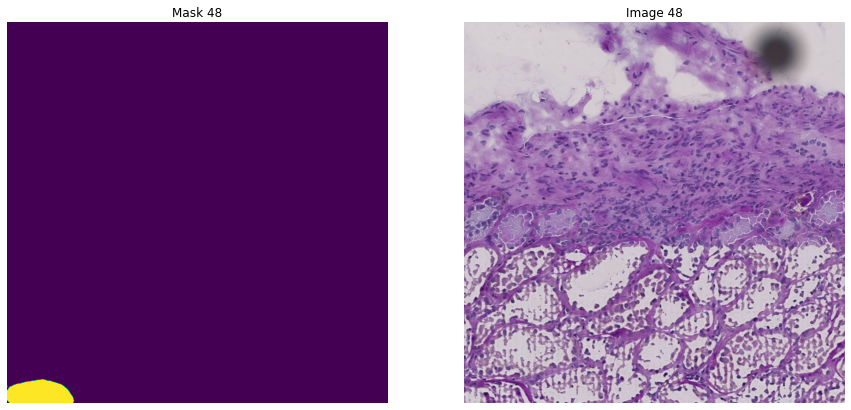

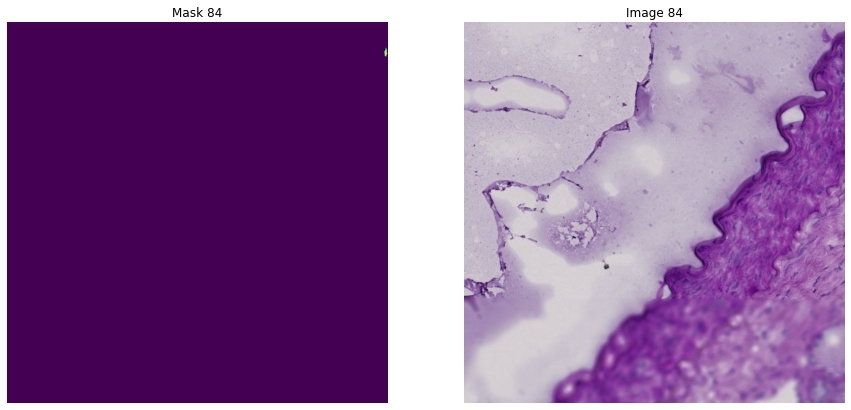

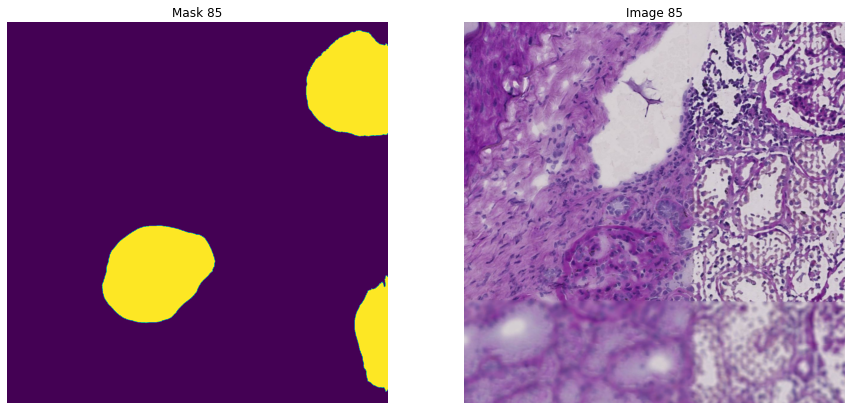

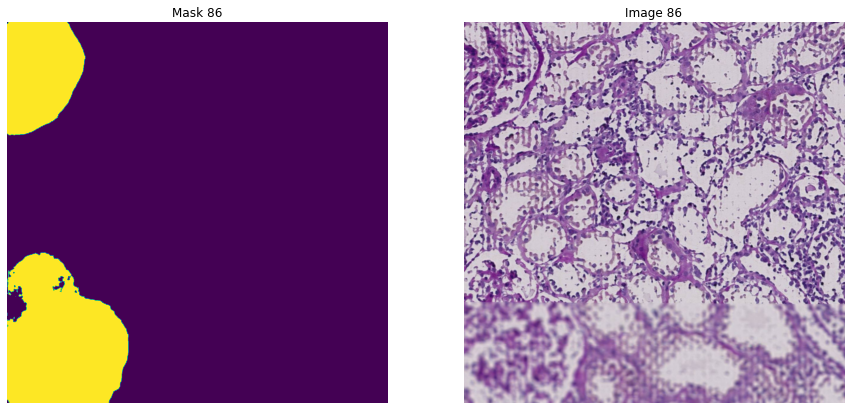

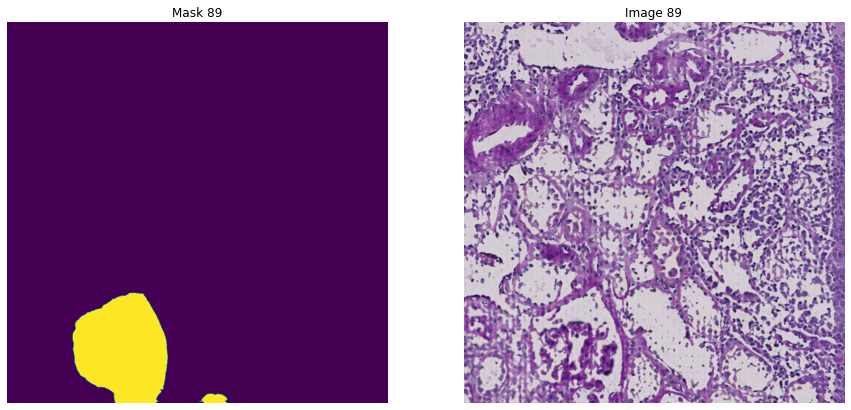

...

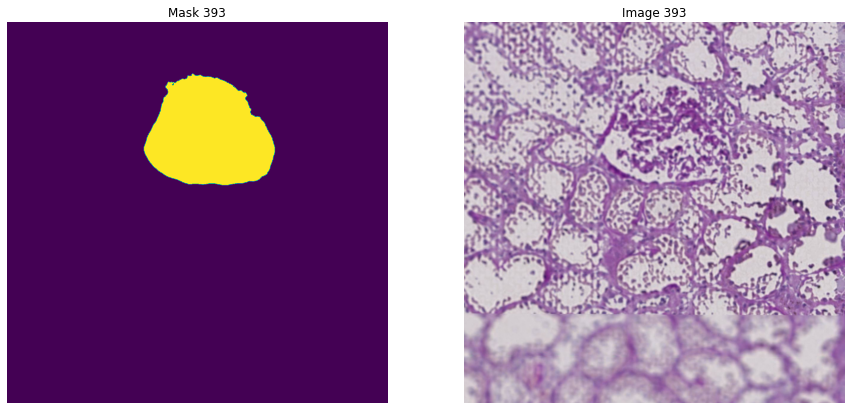

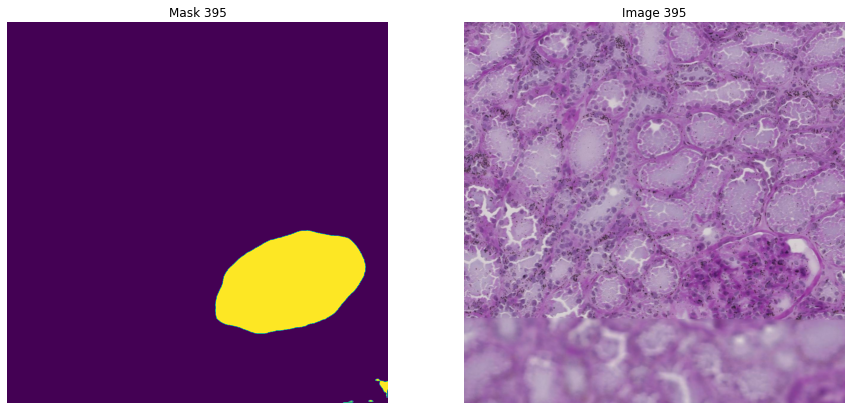

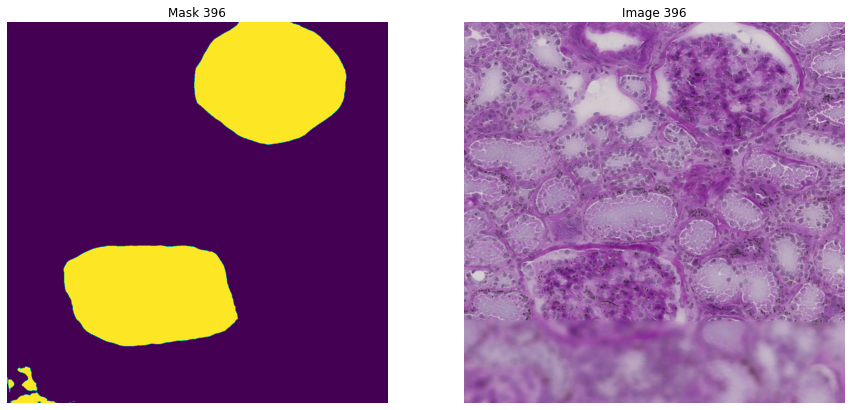

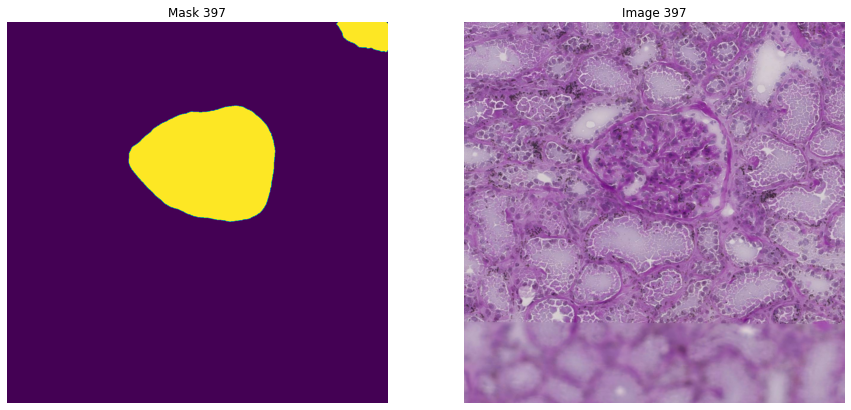

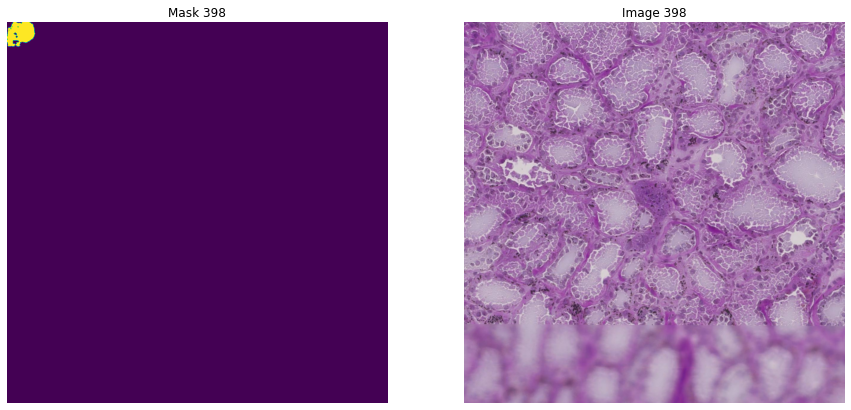

In [43]:
%%time

# preprocess_input = get_preprocessing(mean=[-0.0401, -0.0352,  0.0137], std=[0.9670, 0.9401, 0.9414])

preprocess_input = get_preprocessing()

submissions = create_submission(process_score_func, preprocess_input, fold_models,
                                window=WINDOW, new_size=NEW_SIZE, overlaps=overlaps, threshold=0.4)

In [ ]:
from collections import defaultdict
grouped_submissions = defaultdict(list)

for s_dict in submissions:
    for index, v in s_dict.items():
        grouped_submissions[v['id']].append({'predicted': v['predicted'], 'shape': v['shape']})

In [ ]:
mask_threshold = 1 / 2 - 0.01
mask_threshold

In [ ]:
%%time

subm = {}
for i, (k, v) in enumerate(grouped_submissions.items()):
    mean_mask = np.zeros([v[0]['shape'][0], v[0]['shape'][1]], dtype=np.float16)
    mask_len = len(v)
    print(f'{i + 1}. Processing {k} with {mask_len} masks')
    for encoded in v:
        mean_mask += rle_decode(encoded['predicted'], encoded['shape'])
    print(f'Finished adding {mask_len} masks')
    mean_mask = mean_mask / mask_len
    mean_mask = (mean_mask > mask_threshold).astype(np.uint8)
    subm[i] = {'id': k, 'predicted': rle_encode_less_memory(mean_mask)}
    print(f'Finished encoding average')
    
    
#6min 24s

In [ ]:
submission = pd.DataFrame.from_dict(subm, orient='index')
submission.to_csv('submission.csv', index=False)
submission

In [ ]:
!du -h submission.csv
!du -k submission.csv

In [ ]:
for k, v in subm.items():
    test_file = TEST_PATH/f'{v["id"]}.tiff'
    assert test_file.exists()
    dataset = rasterio.open(test_file.as_posix(), transform = identity)
    shape = dataset.shape
    print(test_file, shape)
    image = rle_decode(v['predicted'], shape)
    print(image.shape, image.dtype)
    cv2.imwrite(str(TEST_PATH/f'{v["id"]}_mask.png'), image * 255)